This note book is a cleaned up version of the Test_MapByCongressionalDistrict and Test_MapByCongresionalDistrict_2 notebooks.

I've been able to match the PPP data to state-level, but I'd like to get smaller regions.

While the PPP data has a "CountyProjectName" field that records the county in which the project takes place, the county names differ from those used in the Census Dept. This makes it hard to match the records from the PPP with Census data.

This notebook will explore using the CD (Project Congressional District) to see if this can be matched against the Census Dept's data.

In [2]:
import pandas as pd
pd.options.display.max_colwidth = 400
pd.options.display.max_columns = 90

In [3]:
import glob
workDir = '/home/alp/Google Drive/Python/analysis/PPP_analysis/data/'

file_names = sorted(glob.glob(workDir+'public_up_to*.csv'))
firstFile = 'public_150k_plus_220930.csv'

colList = ['LoanNumber','CD','BorrowerZip','ProjectZip','ProjectCountyName',
            'JobsReported','NAICSCode',
            'Race','Ethnicity','Gender','Veteran',
            'BusinessType','ForgivenessAmount']

df = pd.read_csv(workDir+firstFile, usecols = colList)
#df = df[df['NAICSCode'] == 813110]

for file in file_names:
    oldDF = df
    #print(file)
    if firstFile not in file:
        newDF = pd.read_csv(file, usecols = colList)
        #newDF = newDF[newDF['NAICSCode'] == 813110]
        df = pd.concat([oldDF,newDF])

#df.info()        

In [4]:
f"{df['CD'].isna().sum():,}"

'526'

In [5]:
f"{df[df['CD'].isna()]['ForgivenessAmount'].sum():,.0f}"

'32,413,713'

So only 525 loans went to places without a congressional district. The total amount of these loans was $33.4M, which is a drop in the PPP bucket. Let's drop them.

In [6]:
df = df.dropna(subset=['CD'])

In [7]:
# get state boundary data
import geopandas as gpd
cd_borders = gpd.read_file("/home/alp/Google Drive/Python/GeoShapeFiles/cb_2021_us_cd116_5m.zip")
#states.rename(columns={'STUSPS':'state'},inplace = True)
#states = states[['state','geometry']]
cd_borders.head()

,STATEFP,CD116FP,AFFGEOID,GEOID,NAMELSAD,LSAD,CDSESSN,ALAND,AWATER,geometry
0,13,01,5001600US1301,1301,Congressional District 1,C2,116,21048454728,2075282171,"POLYGON ((-83.24455 30.97380, -83.21895 30.97327, -83.22057 30.99148, -83.18823 31.00812, -83.18049 31.01673, -83.17946 30.95013, -83.04292 30.94730, -83.02724 30.91477, -83.02106 30.88177, -83.02599 30.86467, -83.01942 30.84945, -83.01396 30.84471, -83.00658 30.85947, -82.97134 30.86939, -82.97125 31.18399, -82.67167 31.18374, -82.69084 31.22336, -82.70105 31.22322, -82.69921 31.27810, -82.66..."
1,22,04,5001600US2204,2204,Congressional District 4,C2,116,32210673963,1104876825,"POLYGON ((-94.04315 32.69303, -94.04295 32.76799, -94.04303 32.77686, -94.04294 32.78056, -94.04283 32.78528, -94.04275 32.78697, -94.04303 32.79748, -94.04278 32.87149, -94.04303 32.88045, -94.04289 32.88097, -94.04289 32.88109, -94.04286 32.89277, -94.04288 32.89891, -94.04309 32.91002, -94.04307 32.93790, -94.04309 32.95559, -94.04296 33.01922, -94.04144 33.01919, -94.03584 33.01915, -94.02..."
2,32,02,5001600US3202,3202,Congressional District 2,C2,116,144774070355,1139466145,"POLYGON ((-120.00574 39.22866, -120.00514 39.29126, -120.00541 39.31334, -120.00541 39.31385, -120.00532 39.31635, -120.00532 39.31645, -120.00471 39.33049, -120.00443 39.37491, -120.00312 39.44504, -120.00312 39.44511, -120.00174 39.53885, -120.00132 39.72242, -120.00050 39.77996, -120.00061 39.78078, -119.99973 39.85141, -119.99763 39.95650, -119.99729 40.07180, -119.99717 40.07724, -119.997..."
3,38,00,5001600US3800,3800,Congressional District (at Large),C1,116,178694310772,4414779956,"POLYGON ((-104.04865 48.86573, -104.04882 48.86754, -104.04888 48.87401, -104.04889 48.87574, -104.04872 48.87992, -104.04864 48.90261, -104.04875 48.90686, -104.04874 48.91211, -104.04881 48.93364, -104.04870 48.94033, -104.04877 48.94330, -104.04887 48.94963, -104.04870 48.95182, -104.04863 48.95712, -104.04880 48.95900, -104.04855 48.96377, -104.04862 48.96674, -104.04848 48.98701, -104.048..."
4,53,04,5001600US5304,5304,Congressional District 4,C2,116,49848533001,807764492,"POLYGON ((-121.51425 46.89099, -121.49699 46.90834, -121.45645 46.92358, -121.44946 46.93435, -121.45838 46.96057, -121.44214 46.97294, -121.44584 46.98022, -121.40646 46.99874, -121.40619 47.01218, -121.39474 47.02327, -121.39980 47.03346, -121.37412 47.05700, -121.37996 47.08725, -121.37968 47.08749, -121.35924 47.07074, -121.34714 47.07874, -121.31126 47.07691, -121.28072 47.08873, -121.222..."


The PPP codes the CD by state-district (MD-01)

The census bureau uses state FP number and CD116FP numbers. (02-01)

I think the easiest way to deal with this is to change the CD_df.
1. Match the STATEFP to the 2 letter codes. Add the 2letter codes to CD temporarily.
1. Combine the temp 2letter code with the CD116FP to create a new CD field.

In [8]:
fips_state = pd.read_excel('/home/alp/Google Drive/Python/GeoShapeFiles/FIPS_dictionary.xlsx','States',dtype='object')
fips_state.head()

,Stabr,State FIPS
0,AL,01
1,AK,02
2,AZ,04
3,AR,05
4,CA,06


The next cell combines the congressional df with the FIPS data.

It then adds a "CD" field that combines the state abbreviation + "-" + CD number
> TX-01

In [9]:
cd_borders = pd.merge(left=cd_borders,right=fips_state,left_on='STATEFP',right_on='State FIPS',how='left')
cd_borders['CD'] = cd_borders['Stabr'] + '-' + cd_borders['CD116FP']
cd_data = cd_borders[['CD','geometry']]
cd_data.head()

,CD,geometry
0,GA-01,"POLYGON ((-83.24455 30.97380, -83.21895 30.97327, -83.22057 30.99148, -83.18823 31.00812, -83.18049 31.01673, -83.17946 30.95013, -83.04292 30.94730, -83.02724 30.91477, -83.02106 30.88177, -83.02599 30.86467, -83.01942 30.84945, -83.01396 30.84471, -83.00658 30.85947, -82.97134 30.86939, -82.97125 31.18399, -82.67167 31.18374, -82.69084 31.22336, -82.70105 31.22322, -82.69921 31.27810, -82.66..."
1,LA-04,"POLYGON ((-94.04315 32.69303, -94.04295 32.76799, -94.04303 32.77686, -94.04294 32.78056, -94.04283 32.78528, -94.04275 32.78697, -94.04303 32.79748, -94.04278 32.87149, -94.04303 32.88045, -94.04289 32.88097, -94.04289 32.88109, -94.04286 32.89277, -94.04288 32.89891, -94.04309 32.91002, -94.04307 32.93790, -94.04309 32.95559, -94.04296 33.01922, -94.04144 33.01919, -94.03584 33.01915, -94.02..."
2,NV-02,"POLYGON ((-120.00574 39.22866, -120.00514 39.29126, -120.00541 39.31334, -120.00541 39.31385, -120.00532 39.31635, -120.00532 39.31645, -120.00471 39.33049, -120.00443 39.37491, -120.00312 39.44504, -120.00312 39.44511, -120.00174 39.53885, -120.00132 39.72242, -120.00050 39.77996, -120.00061 39.78078, -119.99973 39.85141, -119.99763 39.95650, -119.99729 40.07180, -119.99717 40.07724, -119.997..."
3,ND-00,"POLYGON ((-104.04865 48.86573, -104.04882 48.86754, -104.04888 48.87401, -104.04889 48.87574, -104.04872 48.87992, -104.04864 48.90261, -104.04875 48.90686, -104.04874 48.91211, -104.04881 48.93364, -104.04870 48.94033, -104.04877 48.94330, -104.04887 48.94963, -104.04870 48.95182, -104.04863 48.95712, -104.04880 48.95900, -104.04855 48.96377, -104.04862 48.96674, -104.04848 48.98701, -104.048..."
4,WA-04,"POLYGON ((-121.51425 46.89099, -121.49699 46.90834, -121.45645 46.92358, -121.44946 46.93435, -121.45838 46.96057, -121.44214 46.97294, -121.44584 46.98022, -121.40646 46.99874, -121.40619 47.01218, -121.39474 47.02327, -121.39980 47.03346, -121.37412 47.05700, -121.37996 47.08725, -121.37968 47.08749, -121.35924 47.07074, -121.34714 47.07874, -121.31126 47.07691, -121.28072 47.08873, -121.222..."


Weirdly, there are five rows in this df that have NaN values for CD. The regions they point to are not in the continential US (several are in the ocean surrounding Anarticica.) See the exploration in XXX_2 notebook.

We will drop them.

In [10]:
cd_data = cd_data.dropna(subset=['CD'])
cd_data.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 436 entries, 0 to 440
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   CD        436 non-null    object  
 1   geometry  436 non-null    geometry
dtypes: geometry(1), object(1)
memory usage: 10.2+ KB


OK, so now I've got a geo df that has CDs formatted in the same manner as the PPP data, along with the geometry for the region.

Let's get mapping!

In [11]:
map1 = df.groupby(['CD'])[['ForgivenessAmount','JobsReported']].sum()
# .count() creates a series, where the index is the CD number and the value column is "ForgivenessAmount"
map1 = map1.reset_index()
# .reset_index() converts the series to a df, with two columns: CD and ForgivenessAmt
map1.rename(columns={'ForgivenessAmount':'TotalCost'},inplace=True) 
# this step isn't needed, but we're not looking at a LoanNumber, but at the number of loans
map1.head()

,CD,TotalCost,JobsReported
0,AE-,6.162556e+05,44.0
1,AK-,1.942943e+09,198450.0
2,AL-01,1.523277e+09,192168.0
3,AL-02,1.184153e+09,152737.0
4,AL-03,9.037094e+08,125517.0


The sum function shows that there is some unwanted information in the PPP dataset, including records for non-states (Puerto Rico, Guam, etc.) We will delete these since
1. they tend to be for smaller amounts and
1. we are tracking congressional districts, so areas without a CD are outside our area of study. 

The exception to this rule is DC. It got a lot of loans and congress oversees (interferes) with it more than other non-represented areas.

There is also some crap in the data we want to study. For example, there are four rows for WY ("WY-, WY-01, WY-02, WY-03). Since WY has only one congressional district, we need to fix this by gathering all the loans into one amount and assigning them to WY-00. We will do this for all the single-rep districts.

In [12]:
invalid_districts = map1[map1['CD'].str.len() == 3]['CD'].tolist()

#for district in invalid_districts:
#    print(f"state: {district} number of loans: {len(df[df['CD'] == district])}")

We've got a list of the 'invalid districts' (those that don't have a NN after the dash). We will remove the valid districts (the seven states with a single rep + DC) and drop the invalid districts from the summary (map1) df.

In [13]:
single_rep_list = ['AK-', 'DE-', 'MT-', 'ND-', 'SD-', 'VT-', 'WY-','DC-']
for district in single_rep_list:
    invalid_districts.remove(district)

#invalid_districts

for district in invalid_districts:
    map1.drop(map1.loc[map1['CD'] == district].index, inplace = True )

Now, we will fix the data for the seven single rep districts

In [14]:
# first, let's set up a dictionary with the correct districts and total amount spent in the state
dists, spent, jobs = [], [], []
for district in single_rep_list: # AK-, VT-, WY- etc.
    fix_str = district + '00'
    temp_spend = map1[map1['CD'].str.contains(district)]['TotalCost'].sum()
    temp_jobs  = map1[map1['CD'].str.contains(district)]['JobsReported'].sum()
    dists.append(fix_str)
    spent.append(temp_spend)
    jobs.append(temp_jobs)

# next, delete the messed up districts
    map1.drop (map1[map1['CD'].str.contains(district)].index, inplace=True )


fixed = {'CD':dists,'TotalCost':spent, 'JobsReported':jobs} # create a dictionary with the new/correct info

# now add the fixed dictionary to the map data
fixed_dist_df = pd.DataFrame.from_dict(fixed)

map1 = pd.concat([map1,fixed_dist_df])

map1.loc[map1['CD'] == 'DC-00','CD'] = 'DC-98' # Why is DC-98 and not DC-00? WTF knows. 

In [15]:
import folium

m1= folium.Map(location=[40,-90],
                tiles='OpenStreetMap',zoom_start = 4)

title = 'Total Cost of PPP loans'

cp = folium.Choropleth(
    geo_data = cd_data,
    name = 'choropleth',
    data = map1, 
    columns = ['CD','TotalCost'],
    key_on = 'feature.properties.CD',
    bins = 5,
    fill_color='OrRd',
    fill_opacity=0.8,
    line_opacity=0.2,
    nan_fill_color = 'grey',
    legend_name=title
    ).add_to(m1)

m1

Got it -- but the scale is a mess and I want to add hover tips.

Let's add a column for the cost in millions of dollars. 

In [16]:
map1['Millions'] = map1['TotalCost']/10**6

In [17]:
import folium

m1= folium.Map(location=[40,-90],
                tiles='OpenStreetMap',zoom_start = 4)

title = 'Total Cost of PPP loans (Millions)'

cp = folium.Choropleth(
    geo_data = cd_data,
    name = 'choropleth',
    data = map1, 
    columns = ['CD','Millions'],
    key_on = 'feature.properties.CD',
    bins = 5,
    fill_color='OrRd',
    fill_opacity=0.8,
    line_opacity=0.2,
    nan_fill_color = 'grey',
    legend_name=title
    ).add_to(m1)

hover_data = map1.set_index('CD')

# the next few rows will go through the geojson data and add information from the map1 df
# this will be displayed as toolTip -- information to be shown when hovering over a region
# locate in the hover_data table INDEX column -- based on info from the geojson df (row/properties/CD)
# and return the "Billions" figure to be added to the geojson "properties" field
for row in cp.geojson.data['features']:
    try:
        row['properties']['Millions'] = f"${hover_data.loc[row['properties']['CD'],'Millions']:,.0f}M"
    except KeyError:
        row['properties']['Millions'] = 'No loans'
    try:
        row['properties']['Jobs'] = f"{hover_data.loc[row['properties']['CD'],'JobsReported']:,.0f}"
    except KeyError:
        row['properties']['Jobs'] = 'No data'

folium.GeoJsonTooltip(['CD','Millions','Jobs'],aliases=['CD #:','Cost:','Jobs:']).add_to(cp.geojson)


m1

Tooltips is working

Scale looks better (in Millions) but problem with long tail. I'll do what I've done before: find the mean and the SD, then create a new "capped" field in the DF that is the mean + 3SD.

I will use the capped field to color the map, but keep the original field in the hover tips, so folks can see the actual amounts (if larger).

In [18]:
map1['Millions'].describe()

count     436.000000
mean     1723.053090
std       779.986168
min       695.139111
25%      1223.678053
50%      1555.955356
75%      2086.527961
max      9144.167564
Name: Millions, dtype: float64

In [19]:
map1['Millions'].mean() + map1['Millions'].std()*3

4063.011594415375

In [20]:
map1['Millions'].sort_values(ascending = False).head(10)

298    9144.167564
296    7299.881493
150    4838.467611
36     4289.334640
406    4183.581161
57     4175.309542
69     3825.585668
195    3594.038781
78     3474.178689
442    3312.494785
Name: Millions, dtype: float64

There are only six(!) districts that are greater than mean + 3SD. So capping them seems reasonable, since it will make the map more usefully ledgibly. 

In [22]:
maxValue = map1['Millions'].mean() + 3 * map1['Millions'].std()
map1['Millions_scale'] = map1['Millions'].apply(lambda x: x if x < maxValue else maxValue)

In [23]:
import folium

m1= folium.Map(location=[40,-90],
                tiles='OpenStreetMap',zoom_start = 4)

title = 'Total Cost of PPP loans (Millions)'

#myscale = (map1['Millions'].quantile((0,0.25,0.5,0.98,1))).tolist()

cp = folium.Choropleth(
    geo_data = cd_data,
    name = 'choropleth',
    data = map1, 
    columns = ['CD','Millions_scale'],
    key_on = 'feature.properties.CD',
    bins = 9,
    #threshold_scale = myscale,
    fill_color='YlGnBu',
    fill_opacity=0.8,
    line_opacity=0.2,
    nan_fill_color = 'grey',
    legend_name=title
    ).add_to(m1)

hover_data = map1.set_index('CD')

# the next few rows will go through the geojson data and add information from the map1 df
# this will be displayed as toolTip -- information to be shown when hovering over a region
# locate in the hover_data table INDEX column -- based on info from the geojson df (row/properties/CD)
# and return the "Billions" figure to be added to the geojson "properties" field
for row in cp.geojson.data['features']:
    try:
        row['properties']['Millions'] = f"${hover_data.loc[row['properties']['CD'],'Millions']:,.0f}M"
    except KeyError:
        row['properties']['Millions'] = 'No loans'
    try:
        row['properties']['Jobs'] = f"{hover_data.loc[row['properties']['CD'],'JobsReported']:,.0f}"
    except KeyError:
        row['properties']['Jobs'] = 'No data'

folium.GeoJsonTooltip(['CD','Millions'],aliases=['CD #:','Cost:']).add_to(cp.geojson)


m1

In theory, house districts have the same number of people. In 2010, the average was 710K; the largest was MT (994K) and the smallest RI-1 (526K). __[https://en.wikipedia.org/wiki/List_of_United_States_congressional_districts]__

For any given state, the districts should have roughly the same population. __[https://www.census.gov/programs-surveys/geography/guidance/geo-areas/congressional-dist.html]__

This map makes it clear that different congressional districts in a given state received wildly different amounts of PPP funds, although they should have had roughly the same number of residents (or did so in 2010 when the districts were drawn).

| district | total PPP spent |
| :-- | --: |
| IL-07 | 4,838m |
| IL-12 | 1,134m |
|||
| MA-08 | 3,594m |
| MA-01 | 1,601m |
|||
| WA-07 | 3,312m |
| WA-10 | 1,238m |

These are significantly different amounts for the same state. Since the goal was to replace payroll, we'd expect places with high-income workers to get more money. Is this the major factor? 

Let's get some demographic data for the different CDs. I've combined two spreadsheets from DailyKOS:
1. Congressional districts - Pct Bachelors, Income, pct vote for Presidential candidates https://docs.google.com/spreadsheets/d/1mCaLsoAuf19srhnU3UL37MoEOk4kcd_JxEgj96vIgJk/edit#gid=77378064
1. CD - racial data (W, B, L, A, Native, Ohter) https://docs.google.com/spreadsheets/d/14gFG9uQgJ-qTq3lkTNQ9YbhB9C8s3Gy78I1eqd7EpRM/edit#gid=1893110628

DailyKOS doesn't include DC, so I found DC's data at the census department and Balletopedia.

I've combined them to create a single sheet with data for the 2019-2021 congress. Demographics about
 * district population (White, Black, Latino, AAPI, Other)
 * how the district voted for president in 2020, 2016, 2012
 * median income, median White income



In [71]:
cdDemo = pd.read_excel('/home/alp/Google Drive/Python/GeoShapeFiles/2019CongressDistDemo.xlsx')
cdDemo.head()

,CD,tPopWPct,tPopBPct,tPopLPct,TpopAAPIPct,TpopNatPct,TpopOthPct,votPopWPct,votPopBPct,votPopLPct,votPopAAPIPct,votPopNativePct,votPopOtherPct,d20,r20,d16,r16,d12,r12,medInc,W_medInc
0,AK-00,60.863696,3.127947,7.037371,7.358238,14.432920,7.179828,64.725200,3.233365,6.141946,7.395847,13.162347,5.341295,43.0,53.1,37.6,52.8,41.2,55.3,77640,85841.0
1,AL-01,65.226789,27.486517,3.226874,1.495501,1.070227,1.494093,67.525076,26.036395,2.741491,1.476257,1.063344,1.157437,35.3,63.7,34.1,63.5,37.4,61.8,49773,58828.0
2,AL-02,61.511130,31.244391,3.746561,1.223352,0.357516,1.917050,63.963116,30.233376,2.922192,1.251961,0.384049,1.245306,35.1,63.9,33.0,64.9,36.4,62.9,48611,57192.0
3,AL-03,67.586421,25.507663,3.126036,1.864195,0.272259,1.643426,69.316138,24.988477,2.512404,1.778565,0.279256,1.125159,33.7,65.3,32.3,65.3,36.8,62.3,49110,54477.0
4,AL-04,83.445662,6.996035,6.612681,0.595112,0.636733,1.713777,85.820740,6.904280,4.747224,0.588202,0.680877,1.258676,17.8,81.2,17.4,80.4,24.0,74.8,45111,47566.0


In [72]:
map2 = pd.merge(left=map1,right=cdDemo,left_on='CD',right_on='CD',how='left')
map2.head()

,CD,TotalCost,JobsReported,Millions,Millions_scale,tPopWPct,tPopBPct,tPopLPct,TpopAAPIPct,TpopNatPct,TpopOthPct,votPopWPct,votPopBPct,votPopLPct,votPopAAPIPct,votPopNativePct,votPopOtherPct,d20,r20,d16,r16,d12,r12,medInc,W_medInc
0,AL-01,1.523277e+09,192168.0,1523.277381,1523.277381,65.226789,27.486517,3.226874,1.495501,1.070227,1.494093,67.525076,26.036395,2.741491,1.476257,1.063344,1.157437,35.3,63.7,34.1,63.5,37.4,61.8,49773,58828.0
1,AL-02,1.184153e+09,152737.0,1184.153103,1184.153103,61.511130,31.244391,3.746561,1.223352,0.357516,1.917050,63.963116,30.233376,2.922192,1.251961,0.384049,1.245306,35.1,63.9,33.0,64.9,36.4,62.9,48611,57192.0
2,AL-03,9.037094e+08,125517.0,903.709373,903.709373,67.586421,25.507663,3.126036,1.864195,0.272259,1.643426,69.316138,24.988477,2.512404,1.778565,0.279256,1.125159,33.7,65.3,32.3,65.3,36.8,62.3,49110,54477.0
3,AL-04,9.740177e+08,127785.0,974.017707,974.017707,83.445662,6.996035,6.612681,0.595112,0.636733,1.713777,85.820740,6.904280,4.747224,0.588202,0.680877,1.258676,17.8,81.2,17.4,80.4,24.0,74.8,45111,47566.0
4,AL-05,1.283131e+09,158848.0,1283.130847,1283.130847,72.495002,17.600922,5.217530,1.805347,0.585124,2.296074,74.495791,17.254651,4.039892,1.822174,0.614206,1.773286,35.7,62.7,31.3,64.7,34.9,63.9,57758,62647.0


Now that I've got the demographic data loaded and added to the DF, we will create a correlation table to see if any of these variables relate to the PPP cost.

In [73]:
map2.corr()

/tmp/ipykernel_100825/1653304048.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  map2.corr()


,TotalCost,JobsReported,Millions,Millions_scale,tPopWPct,tPopBPct,tPopLPct,TpopAAPIPct,TpopNatPct,TpopOthPct,votPopWPct,votPopBPct,votPopLPct,votPopAAPIPct,votPopNativePct,votPopOtherPct,d20,r20,d16,r16,d12,r12,medInc,W_medInc
TotalCost,1.000000,0.977523,1.000000,0.933595,-0.057417,-0.014576,-0.058541,0.362630,-0.075911,0.081094,-0.054659,-0.029532,-0.055702,0.359183,-0.090442,0.076257,0.396731,-0.398071,0.354613,-0.365677,0.254595,-0.257510,0.532445,0.588424
JobsReported,0.977523,1.000000,0.977523,0.914271,-0.072321,-0.024631,-0.018386,0.334002,-0.071432,0.044209,-0.071917,-0.036479,-0.013771,0.331026,-0.089709,0.044330,0.352171,-0.352190,0.318736,-0.328311,0.215174,-0.216864,0.480717,0.539744
Millions,1.000000,0.977523,1.000000,0.933595,-0.057417,-0.014576,-0.058541,0.362630,-0.075911,0.081094,-0.054659,-0.029532,-0.055702,0.359183,-0.090442,0.076257,0.396731,-0.398071,0.354613,-0.365677,0.254595,-0.257510,0.532445,0.588424
Millions_scale,0.933595,0.914271,0.933595,1.000000,-0.067889,-0.006035,-0.062827,0.387699,-0.081448,0.100684,-0.061994,-0.024499,-0.061436,0.384940,-0.099046,0.093231,0.416252,-0.418912,0.363190,-0.379317,0.253575,-0.257166,0.573385,0.628591
tPopWPct,-0.057417,-0.072321,-0.057417,-0.067889,1.000000,-0.445622,-0.756724,-0.392661,0.013996,-0.020537,0.998669,-0.455490,-0.757589,-0.413688,0.014400,-0.102233,-0.659327,0.653492,-0.720934,0.694821,-0.636137,0.631654,0.022084,-0.251196
tPopBPct,-0.014576,-0.024631,-0.014576,-0.006035,-0.445622,1.000000,-0.133582,-0.127256,-0.105788,-0.103501,-0.443103,0.999198,-0.127345,-0.118858,-0.131304,-0.101018,0.413670,-0.399620,0.434105,-0.373258,0.434130,-0.414297,-0.287784,-0.068690
tPopLPct,-0.058541,-0.018386,-0.058541,-0.062827,-0.756724,-0.133582,1.000000,0.167462,-0.016352,-0.180344,-0.757139,-0.118986,0.998528,0.185409,-0.002186,-0.085361,0.341298,-0.341256,0.409531,-0.411480,0.330116,-0.334508,-0.047661,0.122074
TpopAAPIPct,0.362630,0.334002,0.362630,0.387699,-0.392661,-0.127256,0.167462,1.000000,-0.115961,0.446801,-0.399130,-0.121691,0.161459,0.996809,-0.093048,0.463655,0.436961,-0.441175,0.431308,-0.445842,0.359771,-0.369566,0.592462,0.619478
TpopNatPct,-0.075911,-0.071432,-0.075911,-0.081448,0.013996,-0.105788,-0.016352,-0.115961,1.000000,0.208779,0.026915,-0.104036,-0.021156,-0.105216,0.954747,0.201606,-0.115360,0.108580,-0.125950,0.099696,-0.109718,0.105287,-0.117433,-0.130972
TpopOthPct,0.081094,0.044209,0.081094,0.100684,-0.020537,-0.103501,-0.180344,0.446801,0.208779,1.000000,-0.010848,-0.107506,-0.191102,0.457057,0.209330,0.984789,0.104454,-0.116949,0.065468,-0.102834,0.069199,-0.077125,0.215570,0.155301


The first column of the correlation table shows that there ethnic/racial population stats have almsot no correlation to the amount of PPP funds spent in a CD. (The exception is the 0.36 value for AAPI; I suspect this is because there are relatively small numbers of AAPI in many CDs. I suspect they tend to be clustered in urban areas which received relatively large amounts of PPP funds.)

There is a positive correlation between voting for Biden (d20) and PPP spending (0.254) and, correspondinly, a negative correlation beween voting for trump (r20) and PPP spending (-0.259).

The largest positive correlation is between median income (and even more median White income) and PPP spending (0.529 and 0.588). This stands to reason: if the PPP was intended to replace salary, then CDs with high salaries should see higher PPP spending.

But even so, the spending disparities are stark. I'm not sure they can be explained soley by the median income:
| district | total PPP spent | median income |
| :-- | --: | --:|
| IL-07 | 4,838m | 60,216 |
| IL-12 | 1,134m | 50,948 |
||||
| MA-08 | 3,594m | 93,015 |
| MA-01 | 1,601m | 59,137 |
||||
| WA-07 | 3,312m | 92,287 |
| WA-10 | 1,238m | 68,184 |

In IL, there is a 20% difference in median income and a 430% difference in PPP spending.
In MA, the difference is about 56% in income and a 220% difference in spending.
In WA, the difference is about 35% in income with a 270% difference in spending.

Can this be the explanation?

In [74]:
map2['JobCost'] = round(map2['TotalCost'] / map2['JobsReported'])
map2.sort_values(by='JobCost',ascending=False).head(10)

,CD,TotalCost,JobsReported,Millions,Millions_scale,tPopWPct,tPopBPct,tPopLPct,TpopAAPIPct,TpopNatPct,TpopOthPct,votPopWPct,votPopBPct,votPopLPct,votPopAAPIPct,votPopNativePct,votPopOtherPct,d20,r20,d16,r16,d12,r12,medInc,W_medInc,JobCost
31,CA-12,4.289335e+09,390584.0,4289.334640,4063.011594,43.061138,5.189969,14.744468,32.604491,0.201934,4.198000,44.691071,5.059324,13.450747,33.580044,0.197872,3.020943,86.1,11.9,86.2,8.7,84.1,12.5,114085,148026.0,10982.0
184,MA-08,3.594039e+09,330339.0,3594.038781,3594.038781,73.073438,10.774927,5.855782,8.373691,0.201407,1.720755,75.254974,9.756906,5.273239,8.328080,0.180219,1.206582,66.2,32.2,60.4,34.4,57.8,40.8,93015,99991.0,10880.0
406,VA-11,2.537059e+09,239193.0,2537.059367,2537.059367,45.528578,13.041096,18.881436,18.327822,0.204692,4.016375,48.196149,12.662520,16.825189,19.109571,0.224964,2.981606,70.3,28.3,66.9,27.5,62.5,36.3,114483,131075.0,10607.0
435,DC-98,3.076521e+09,292396.0,3076.521293,3076.521293,37.300000,45.800000,11.500000,4.700000,0.060000,3.000000,NaN,NaN,NaN,NaN,NaN,NaN,92.1,5.4,90.9,4.1,NaN,NaN,93547,NaN,10522.0
415,WA-09,2.585834e+09,245820.0,2585.833586,2585.833586,45.205544,11.457126,12.414343,24.816628,0.490331,5.616028,48.889211,10.616006,10.378163,25.537919,0.533656,4.045045,73.3,24.6,70.5,23.3,68.3,29.6,83309,92421.0,10519.0
278,NY-12,9.144168e+09,874069.0,9144.167564,4063.011594,64.881134,4.674296,13.685545,14.419800,0.123299,2.215926,66.323926,4.578696,13.007140,14.472103,0.106828,1.511307,84.1,14.8,83.3,13.5,76.9,21.5,109752,124832.0,10462.0
140,IL-07,4.838468e+09,464300.0,4838.467611,4063.011594,29.365789,45.440549,15.999861,7.391380,0.104026,1.698395,32.380459,43.915166,14.093560,8.164658,0.110578,1.335579,86.3,12.1,87.4,9.2,87.2,11.8,60216,109295.0,10421.0
36,CA-17,2.736650e+09,265184.0,2736.649995,2736.649995,22.558208,2.453972,15.921329,55.764398,0.218601,3.083491,24.673924,2.442328,14.456864,56.059992,0.202784,2.164109,72.5,25.5,73.9,20.5,71.9,25.5,133493,124501.0,10320.0
413,WA-07,3.312495e+09,322578.0,3312.494785,3312.494785,68.825303,4.410543,7.878799,12.967151,0.431855,5.486348,70.633242,4.004489,6.901128,13.914481,0.445112,4.101549,85.7,12.3,82.1,12.2,79.2,18.1,92287,99239.0,10269.0
32,CA-13,2.491296e+09,243136.0,2491.295981,2491.295981,34.619814,16.628171,22.157076,21.387820,0.328365,4.878755,37.010575,16.656822,19.318871,23.048168,0.352782,3.612781,88.9,9.0,87.4,6.8,87.5,9.0,80540,114503.0,10247.0


In [75]:
map2['JobCost'].describe()

count      436.000000
mean      8268.438073
std        854.157367
min       5746.000000
25%       7697.250000
50%       8206.000000
75%       8779.000000
max      10982.000000
Name: JobCost, dtype: float64

In [76]:
map2['medInc'].describe()

count       436.000000
mean      65310.823394
std       17898.582833
min       30238.000000
25%       52929.750000
50%       60886.500000
75%       74166.500000
max      139971.000000
Name: medInc, dtype: float64

We can't look at JobCost, since that would be a circular argument (JC = Total Cost / JobsReported). It's a variable that's generated by two other variables (which is why it is strongly correlated with them).

But we could compare the median income in each district with the number of jobs the PPP "saved" and see if the amount spent is roughly similar.

Since the PPP was designed to __[support workers for 8-24 weeks](https://www.sba.gov/funding-programs/loans/covid-19-relief-options/paycheck-protection-program/ppp-loan-forgiveness)__, I will caculate the expected amount the program should cost by:
1. dividing the median income by 6, to get 2 months ()= 8 weeks) of income (-> 2-months income)
1. multiply that number by the number of jobs reported to be saved (-> expected cost)
1. subtract the expected costs from the actual cost of the PPP program (-> variance)
1. divide the variance by 10**6 (->variance in millions of dollars)

In [77]:
map2['monthly'] = round(map2['medInc'] / 6)
map2['expected'] = map2['monthly'] * map2['JobsReported']
map2['variance'] = map2['TotalCost'] - map2['expected']
map2['varianceMillions'] = map2['variance'] / 10**6
map2.head()

,CD,TotalCost,JobsReported,Millions,Millions_scale,tPopWPct,tPopBPct,tPopLPct,TpopAAPIPct,TpopNatPct,TpopOthPct,votPopWPct,votPopBPct,votPopLPct,votPopAAPIPct,votPopNativePct,votPopOtherPct,d20,r20,d16,r16,d12,r12,medInc,W_medInc,JobCost,monthly,expected,variance,varianceMillions
0,AL-01,1.523277e+09,192168.0,1523.277381,1523.277381,65.226789,27.486517,3.226874,1.495501,1.070227,1.494093,67.525076,26.036395,2.741491,1.476257,1.063344,1.157437,35.3,63.7,34.1,63.5,37.4,61.8,49773,58828.0,7927.0,8296.0,1.594226e+09,-7.094835e+07,-70.948347
1,AL-02,1.184153e+09,152737.0,1184.153103,1184.153103,61.511130,31.244391,3.746561,1.223352,0.357516,1.917050,63.963116,30.233376,2.922192,1.251961,0.384049,1.245306,35.1,63.9,33.0,64.9,36.4,62.9,48611,57192.0,7753.0,8102.0,1.237475e+09,-5.332207e+07,-53.322071
2,AL-03,9.037094e+08,125517.0,903.709373,903.709373,67.586421,25.507663,3.126036,1.864195,0.272259,1.643426,69.316138,24.988477,2.512404,1.778565,0.279256,1.125159,33.7,65.3,32.3,65.3,36.8,62.3,49110,54477.0,7200.0,8185.0,1.027357e+09,-1.236473e+08,-123.647272
3,AL-04,9.740177e+08,127785.0,974.017707,974.017707,83.445662,6.996035,6.612681,0.595112,0.636733,1.713777,85.820740,6.904280,4.747224,0.588202,0.680877,1.258676,17.8,81.2,17.4,80.4,24.0,74.8,45111,47566.0,7622.0,7518.0,9.606876e+08,1.333008e+07,13.330077
4,AL-05,1.283131e+09,158848.0,1283.130847,1283.130847,72.495002,17.600922,5.217530,1.805347,0.585124,2.296074,74.495791,17.254651,4.039892,1.822174,0.614206,1.773286,35.7,62.7,31.3,64.7,34.9,63.9,57758,62647.0,8078.0,9626.0,1.529071e+09,-2.459400e+08,-245.940001


In [78]:
map2['varianceMillions'].describe()

count     436.000000
mean     -611.672343
std       805.061414
min     -6844.302584
25%      -819.944753
50%      -362.490170
75%      -152.355063
max       830.726878
Name: varianceMillions, dtype: float64

On average, the PPP didn't cover the cost of 2 months of the median income. The average district saw a short-fall of $611m. But the SD is large (805m). Interestingly, there is a long tail to the left of the mean, so there are a lot more districts that didn't get fully funded than those who got excessive payments.

Let's cap the distribution on both sides of the mean at 3SD, so we will have more intellible map. 

<AxesSubplot: ylabel='Frequency'>

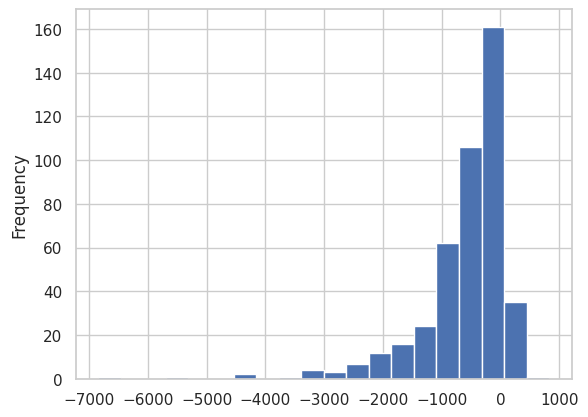

In [79]:
map2['varianceMillions'].plot.hist(bins=20)

Let's do the mean + 3 SD limit again to see how many values would be excluded:

In [80]:
maxValue = map2['varianceMillions'].mean() + map2['varianceMillions'].std()
minValue = map2['varianceMillions'].mean() - 3 * map2['varianceMillions'].std()
map2['varianceMillions_scale'] = map2['varianceMillions'].apply(lambda x: x if (x < maxValue and x > minValue) else minValue if (x < minValue) else maxValue )

nMax = len(map2[map2['varianceMillions_scale'] == maxValue])
nMin = len(map2[map2['varianceMillions_scale'] == minValue])
print(f"Number of values beyond 3SD of mean: {nMax+nMin}, which is \
    {100 * (nMin + nMax) / len(map2):,.5f}% of total. ")


Number of values beyond 3SD of mean: 25, which is     5.73394% of total. 


95% of the values fall within the mean + 3SD range. Let's re-draw the histogram and then draw the districts on the map. . . 

<AxesSubplot: ylabel='Frequency'>

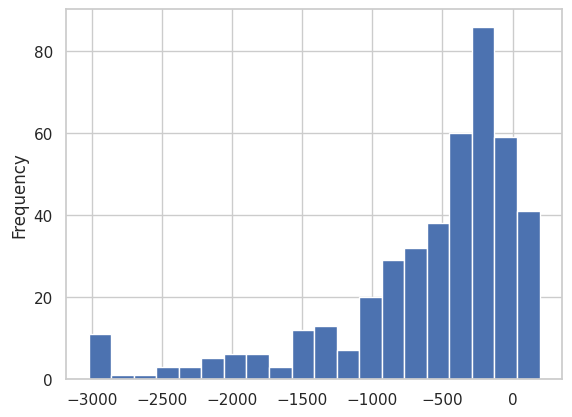

In [81]:
map2['varianceMillions_scale'].plot.hist(bins=20)

In [82]:
map2['CostMillions'] = map2['TotalCost'] / 10**6
map2['expectedMillions'] = map2['expected'] / 10**6

In [83]:
import folium

m= folium.Map(location=[40,-90],
                tiles='OpenStreetMap',zoom_start = 4)

title = 'Variance in expected and actual spending (millions of dollars)'

#myscale = (map1['Millions'].quantile((0,0.25,0.5,0.98,1))).tolist()

cp = folium.Choropleth(
    geo_data = cd_data,
    name = 'choropleth',
    data = map2, 
    columns = ['CD','varianceMillions_scale'],
    key_on = 'feature.properties.CD',
    bins = 9,
    #threshold_scale = myscale,
    fill_color='BuPu',
    fill_opacity=0.8,
    line_opacity=0.2,
    nan_fill_color = 'grey',
    legend_name=title
    ).add_to(m)

hover_data = map2.set_index('CD')

# the next few rows will go through the geojson data and add information from the map1 df
# this will be displayed as toolTip -- information to be shown when hovering over a region
# locate in the hover_data table INDEX column -- based on info from the geojson df (row/properties/CD)
# and return the "Billions" figure to be added to the geojson "properties" field

for row in cp.geojson.data['features']:
    try:
        row['properties']['CostMillions'] = f"${hover_data.loc[row['properties']['CD'],'CostMillions']:,.0f}m"
    except KeyError:
        row['properties']['CostMillions'] = 'No loans'
    try:
        row['properties']['Jobs'] = f"{hover_data.loc[row['properties']['CD'],'JobsReported']:,.0f}"
    except KeyError:
        row['properties']['Jobs'] = 'No data'
    try:
        row['properties']['medInc'] = f"{hover_data.loc[row['properties']['CD'],'medInc']:,.0f}"
    except KeyError:
        row['properties']['medInc'] = 'No data'
    try:
        row['properties']['expectedMillions'] = f"${hover_data.loc[row['properties']['CD'],'expectedMillions']:,.0f}m"
    except KeyError:
        row['properties']['expectedMillions'] = 'No data'
    try:
        row['properties']['varianceMillions'] = f"${hover_data.loc[row['properties']['CD'],'varianceMillions']:,.0f}m"
    except KeyError:
        row['properties']['varianceMillions'] = 'No data'

folium.GeoJsonTooltip(['CD','CostMillions','medInc','expectedMillions','varianceMillions'],
    aliases=['CD #:','Cost:','Median Income:','Expected Cost:','Variance:']).add_to(cp.geojson)


m

In [84]:
import matplotlib.pyplot as plt
%matplotlib inline

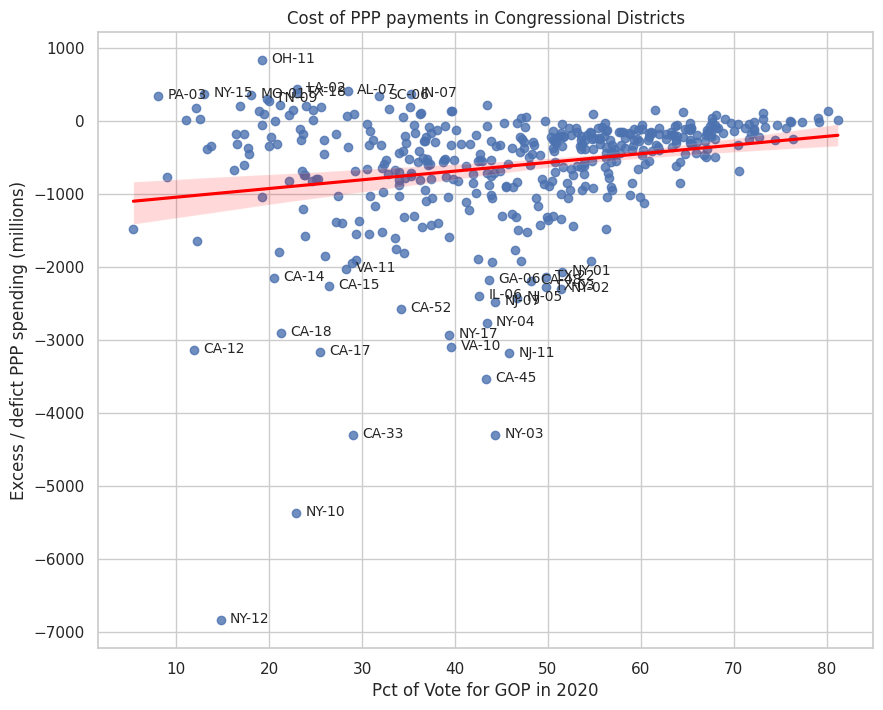

In [92]:
import seaborn as sns
sns.set_theme()
sns.set_style('whitegrid')
fig, ax = plt.subplots(figsize=(10,8))

cd_scatter = sns.regplot( x= map2['r20'], y = map2['varianceMillions'],
    line_kws={"color": "red"})
for index, row in map2.iterrows():
    if row['varianceMillions'] > 300 or row['varianceMillions'] < -2000:
        plt.annotate(row['CD'],(row['r20']+1,row['varianceMillions']-40),fontsize=10)

cd_scatter.set(xlabel = 'Pct of Vote for GOP in 2020',
                ylabel = 'Excess / defict PPP spending (millions)',
                title = 'Cost of PPP payments in Congressional Districts'
                )

plt.show()

In [86]:
len(map2[map2['varianceMillions']>=0])

49

In [87]:
map2['varianceMillions'].describe()

count     436.000000
mean     -611.672343
std       805.061414
min     -6844.302584
25%      -819.944753
50%      -362.490170
75%      -152.355063
max       830.726878
Name: varianceMillions, dtype: float64

Of the 435 CDs, only 49 received more PPP funding than might be expected based on their workers median income. 387 districts received less fuding.

The average shortfall was $611m, but with a lot of variation (SD = $805m). Interstingly, this chart shows that the more GOP-supportive CDs came closer to being "made-whole" by the PPP. 

The districts that that saw the largest gaps between their worker's expected income and the amount received from the PPP were those that cast less than 50% of their votes for the GOP candidate.

For the districts who recevied more from PPP than they might expect based on median income, there is a 0.25 correlation with voting for Biden and a -0.24 correlation with voting for Trump.

It's hard to see the districts that received more money than might be expected. Let's draw just those districts:

In [88]:
import folium

m= folium.Map(location=[40,-90],
                tiles='OpenStreetMap',zoom_start = 4)

title = 'Variance in expected and actual spending (millions of dollars)'

#myscale = (map1['Millions'].quantile((0,0.25,0.5,0.98,1))).tolist()

cp = folium.Choropleth(
    geo_data = cd_data,
    name = 'choropleth',
    data = map2[map2['varianceMillions']>=0], 
    columns = ['CD','varianceMillions'],
    key_on = 'feature.properties.CD',
    bins = 9,
    #threshold_scale = myscale,
    fill_color='BuPu',
    fill_opacity=0.8,
    line_opacity=0.2,
    nan_fill_color = 'grey',
    legend_name=title
    ).add_to(m)

hover_data = map2.set_index('CD')

# the next few rows will go through the geojson data and add information from the map1 df
# this will be displayed as toolTip -- information to be shown when hovering over a region
# locate in the hover_data table INDEX column -- based on info from the geojson df (row/properties/CD)
# and return the "Billions" figure to be added to the geojson "properties" field

for row in cp.geojson.data['features']:
    try:
        row['properties']['CostMillions'] = f"${hover_data.loc[row['properties']['CD'],'CostMillions']:,.0f}m"
    except KeyError:
        row['properties']['CostMillions'] = 'No loans'
    try:
        row['properties']['Jobs'] = f"{hover_data.loc[row['properties']['CD'],'JobsReported']:,.0f}"
    except KeyError:
        row['properties']['Jobs'] = 'No data'
    try:
        row['properties']['medInc'] = f"{hover_data.loc[row['properties']['CD'],'medInc']:,.0f}"
    except KeyError:
        row['properties']['medInc'] = 'No data'
    try:
        row['properties']['expectedMillions'] = f"${hover_data.loc[row['properties']['CD'],'expectedMillions']:,.0f}m"
    except KeyError:
        row['properties']['expectedMillions'] = 'No data'
    try:
        row['properties']['varianceMillions'] = f"${hover_data.loc[row['properties']['CD'],'varianceMillions']:,.0f}m"
    except KeyError:
        row['properties']['varianceMillions'] = 'No data'
    try:
        row['properties']['r20'] = f"{hover_data.loc[row['properties']['CD'],'r20']:.1f}%"
    except KeyError:
        row['properties']['r20'] = 'No data'

folium.GeoJsonTooltip(['CD','CostMillions','medInc','expectedMillions','varianceMillions','r20'],
    aliases=['CD #:','Cost:','Median Income:','Expected Cost:','Variance:','Pct GOP vote:']).add_to(cp.geojson)


m

Let's see how this looks if we consider not the absolute amount of money that might be expected / granted, but instead convert these figures to percents.

In [89]:
map2['variancePct'] = round(map2['varianceMillions'] / map2['CostMillions'] * 100,3)
map2.head()

,CD,TotalCost,JobsReported,Millions,Millions_scale,tPopWPct,tPopBPct,tPopLPct,TpopAAPIPct,TpopNatPct,TpopOthPct,votPopWPct,votPopBPct,votPopLPct,votPopAAPIPct,votPopNativePct,votPopOtherPct,d20,r20,d16,r16,d12,r12,medInc,W_medInc,JobCost,monthly,expected,variance,varianceMillions,varianceMillions_scale,CostMillions,expectedMillions,variancePct
0,AL-01,1.523277e+09,192168.0,1523.277381,1523.277381,65.226789,27.486517,3.226874,1.495501,1.070227,1.494093,67.525076,26.036395,2.741491,1.476257,1.063344,1.157437,35.3,63.7,34.1,63.5,37.4,61.8,49773,58828.0,7927.0,8296.0,1.594226e+09,-7.094835e+07,-70.948347,-70.948347,1523.277381,1594.225728,-4.658
1,AL-02,1.184153e+09,152737.0,1184.153103,1184.153103,61.511130,31.244391,3.746561,1.223352,0.357516,1.917050,63.963116,30.233376,2.922192,1.251961,0.384049,1.245306,35.1,63.9,33.0,64.9,36.4,62.9,48611,57192.0,7753.0,8102.0,1.237475e+09,-5.332207e+07,-53.322071,-53.322071,1184.153103,1237.475174,-4.503
2,AL-03,9.037094e+08,125517.0,903.709373,903.709373,67.586421,25.507663,3.126036,1.864195,0.272259,1.643426,69.316138,24.988477,2.512404,1.778565,0.279256,1.125159,33.7,65.3,32.3,65.3,36.8,62.3,49110,54477.0,7200.0,8185.0,1.027357e+09,-1.236473e+08,-123.647272,-123.647272,903.709373,1027.356645,-13.682
3,AL-04,9.740177e+08,127785.0,974.017707,974.017707,83.445662,6.996035,6.612681,0.595112,0.636733,1.713777,85.820740,6.904280,4.747224,0.588202,0.680877,1.258676,17.8,81.2,17.4,80.4,24.0,74.8,45111,47566.0,7622.0,7518.0,9.606876e+08,1.333008e+07,13.330077,13.330077,974.017707,960.687630,1.369
4,AL-05,1.283131e+09,158848.0,1283.130847,1283.130847,72.495002,17.600922,5.217530,1.805347,0.585124,2.296074,74.495791,17.254651,4.039892,1.822174,0.614206,1.773286,35.7,62.7,31.3,64.7,34.9,63.9,57758,62647.0,8078.0,9626.0,1.529071e+09,-2.459400e+08,-245.940001,-245.940001,1283.130847,1529.070848,-19.167


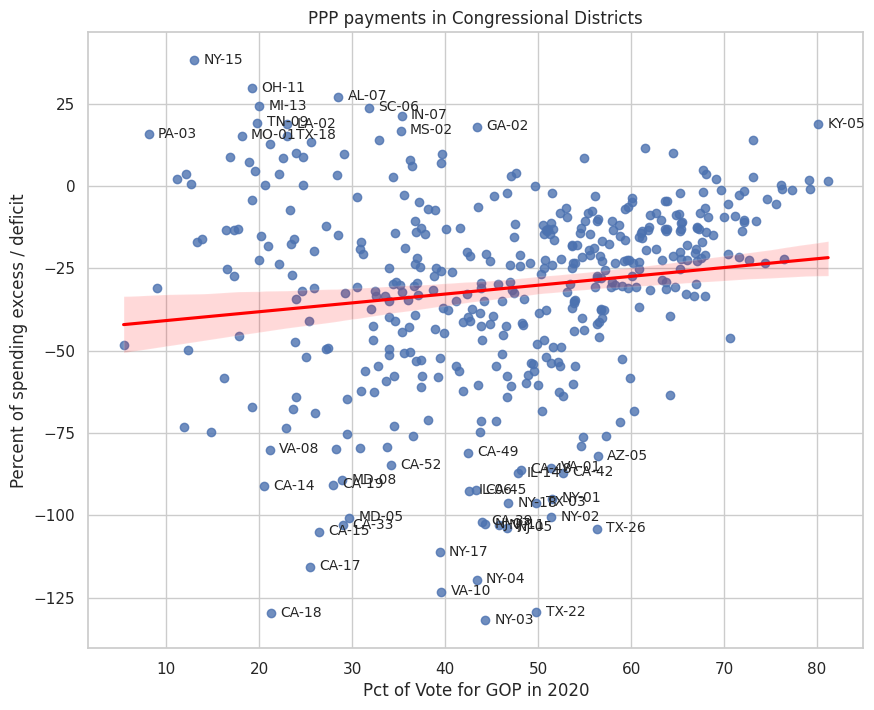

In [90]:
import seaborn as sns
sns.set_theme()
sns.set_style('whitegrid')
fig, ax = plt.subplots(figsize=(10,8))

cd_scatter = sns.regplot( x= map2['r20'], y = map2['variancePct'],
    line_kws={"color": "red"})
for index, row in map2.iterrows():
    if row['variancePct'] > 14 or row['variancePct'] < -80:
        plt.annotate(row['CD'],(row['r20']+1,row['variancePct']-1),fontsize=10)

cd_scatter.set(xlabel = 'Pct of Vote for GOP in 2020',
                ylabel = 'Percent of spending excess / deficit',
                title = 'PPP payments in Congressional Districts'
                )

plt.show()

The same 49 districts will be above the zero (0) line when we think about the percent of PPP funding (and all points X-values will be the same as on the prior scatter plot). But how far they are from zero differs.

Are there similarities between the districts who are > 0 vs those that are < -75%?

In [115]:
# https://stackoverflow.com/questions/29432629/plot-correlation-matrix-using-pandas

corr1 = map2[map2['varianceMillions']>=0].corr()
corr1.style.background_gradient(cmap='coolwarm',axis=None).format(precision=3)

/tmp/ipykernel_100825/2674656055.py:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr1 = map2[map2['varianceMillions']>=0].corr()


,TotalCost,JobsReported,Millions,Millions_scale,tPopWPct,tPopBPct,tPopLPct,TpopAAPIPct,TpopNatPct,TpopOthPct,votPopWPct,votPopBPct,votPopLPct,votPopAAPIPct,votPopNativePct,votPopOtherPct,d20,r20,d16,r16,d12,r12,medInc,W_medInc,JobCost,monthly,expected,variance,varianceMillions,varianceMillions_scale,CostMillions,expectedMillions,variancePct
TotalCost,1.000,0.982,1.000,0.992,-0.310,0.366,-0.030,0.420,-0.186,-0.024,-0.299,0.361,-0.037,0.420,-0.188,-0.021,0.471,-0.474,0.447,-0.451,0.408,-0.410,0.607,0.745,0.730,0.607,0.977,0.290,0.290,0.234,1.000,0.977,-0.102
JobsReported,0.982,1.000,0.982,0.983,-0.327,0.376,-0.026,0.450,-0.178,-0.009,-0.317,0.370,-0.031,0.451,-0.180,-0.005,0.471,-0.475,0.450,-0.455,0.414,-0.417,0.541,0.702,0.614,0.541,0.962,0.272,0.272,0.220,0.982,0.962,-0.129
Millions,1.000,0.982,1.000,0.992,-0.310,0.366,-0.030,0.420,-0.186,-0.024,-0.299,0.361,-0.037,0.420,-0.188,-0.021,0.471,-0.474,0.447,-0.451,0.408,-0.410,0.607,0.745,0.730,0.607,0.977,0.290,0.290,0.234,1.000,0.977,-0.102
Millions_scale,0.992,0.983,0.992,1.000,-0.327,0.385,-0.028,0.425,-0.198,-0.022,-0.315,0.380,-0.035,0.425,-0.200,-0.021,0.489,-0.492,0.462,-0.466,0.421,-0.424,0.603,0.733,0.738,0.603,0.963,0.316,0.316,0.236,0.992,0.963,-0.093
tPopWPct,-0.310,-0.327,-0.310,-0.327,1.000,-0.418,-0.660,-0.348,0.121,0.336,0.999,-0.436,-0.662,-0.364,0.123,0.219,-0.808,0.808,-0.837,0.837,-0.788,0.788,-0.013,-0.427,-0.293,-0.013,-0.249,-0.332,-0.332,-0.428,-0.310,-0.249,-0.269
tPopBPct,0.366,0.376,0.366,0.385,-0.418,1.000,-0.387,-0.056,-0.276,-0.172,-0.414,0.999,-0.378,-0.061,-0.282,-0.155,0.587,-0.582,0.564,-0.533,0.563,-0.550,-0.077,0.380,0.297,-0.077,0.272,0.495,0.495,0.477,0.366,0.272,0.395
tPopLPct,-0.030,-0.026,-0.030,-0.028,-0.660,-0.387,1.000,0.288,-0.018,-0.341,-0.665,-0.366,0.999,0.310,-0.014,-0.245,0.316,-0.320,0.366,-0.389,0.314,-0.324,0.047,0.079,0.048,0.047,-0.017,-0.065,-0.065,0.055,-0.030,-0.017,-0.014
TpopAAPIPct,0.420,0.450,0.420,0.425,-0.348,-0.056,0.288,1.000,-0.121,0.034,-0.340,-0.056,0.272,0.999,-0.122,0.083,0.434,-0.440,0.434,-0.452,0.416,-0.428,0.237,0.444,0.215,0.237,0.424,0.060,0.060,0.150,0.420,0.424,-0.112
TpopNatPct,-0.186,-0.178,-0.186,-0.198,0.121,-0.276,-0.018,-0.121,1.000,0.780,0.132,-0.275,-0.022,-0.121,1.000,0.837,-0.310,0.308,-0.304,0.290,-0.284,0.291,-0.045,-0.171,-0.232,-0.045,-0.154,-0.182,-0.182,-0.258,-0.186,-0.154,-0.184
TpopOthPct,-0.024,-0.009,-0.024,-0.022,0.336,-0.172,-0.341,0.034,0.780,1.000,0.358,-0.185,-0.349,0.019,0.776,0.982,-0.214,0.212,-0.236,0.225,-0.188,0.196,0.105,-0.107,-0.105,0.105,0.009,-0.155,-0.155,-0.316,-0.024,0.009,-0.273


In [116]:
corr2 = map2[map2['varianceMillions']<=-75].corr()
corr2.style.background_gradient(cmap='coolwarm',axis=None).format(precision=3)

/tmp/ipykernel_100825/3593436585.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr2 = map2[map2['varianceMillions']<=-75].corr()


,TotalCost,JobsReported,Millions,Millions_scale,tPopWPct,tPopBPct,tPopLPct,TpopAAPIPct,TpopNatPct,TpopOthPct,votPopWPct,votPopBPct,votPopLPct,votPopAAPIPct,votPopNativePct,votPopOtherPct,d20,r20,d16,r16,d12,r12,medInc,W_medInc,JobCost,monthly,expected,variance,varianceMillions,varianceMillions_scale,CostMillions,expectedMillions,variancePct
TotalCost,1.000,0.977,1.000,0.925,-0.035,-0.082,-0.064,0.355,-0.066,0.074,-0.033,-0.105,-0.059,0.351,-0.086,0.068,0.407,-0.407,0.368,-0.376,0.256,-0.258,0.570,0.582,0.632,0.570,0.941,-0.774,-0.774,-0.674,1.000,0.941,-0.364
JobsReported,0.977,1.000,0.977,0.904,-0.060,-0.084,-0.012,0.319,-0.062,0.028,-0.061,-0.101,-0.005,0.315,-0.087,0.029,0.355,-0.354,0.328,-0.333,0.211,-0.212,0.499,0.522,0.479,0.499,0.920,-0.757,-0.757,-0.657,0.977,0.920,-0.363
Millions,1.000,0.977,1.000,0.925,-0.035,-0.082,-0.064,0.355,-0.066,0.074,-0.033,-0.105,-0.059,0.351,-0.086,0.068,0.407,-0.407,0.368,-0.376,0.256,-0.258,0.570,0.582,0.632,0.570,0.941,-0.774,-0.774,-0.674,1.000,0.941,-0.364
Millions_scale,0.925,0.904,0.925,1.000,-0.043,-0.081,-0.070,0.384,-0.070,0.094,-0.036,-0.110,-0.067,0.381,-0.094,0.086,0.424,-0.426,0.373,-0.386,0.247,-0.250,0.622,0.629,0.701,0.622,0.863,-0.701,-0.701,-0.700,0.925,0.863,-0.396
tPopWPct,-0.035,-0.060,-0.035,-0.043,1.000,-0.371,-0.794,-0.491,-0.010,-0.112,0.999,-0.379,-0.793,-0.513,-0.003,-0.178,-0.607,0.600,-0.674,0.645,-0.563,0.559,-0.126,-0.361,0.087,-0.126,-0.088,0.129,0.129,0.152,-0.035,-0.088,0.205
tPopBPct,-0.082,-0.084,-0.082,-0.081,-0.371,1.000,-0.107,-0.072,-0.078,-0.046,-0.366,0.999,-0.104,-0.061,-0.126,-0.067,0.310,-0.295,0.318,-0.253,0.282,-0.262,-0.123,0.032,-0.049,-0.123,-0.116,0.136,0.136,0.138,-0.082,-0.116,0.126
tPopLPct,-0.064,-0.012,-0.064,-0.070,-0.794,-0.107,1.000,0.178,-0.009,-0.153,-0.794,-0.093,0.998,0.195,0.005,-0.063,0.330,-0.328,0.412,-0.406,0.323,-0.325,-0.036,0.156,-0.251,-0.036,-0.028,-0.012,-0.012,-0.024,-0.064,-0.028,-0.095
TpopAAPIPct,0.355,0.319,0.355,0.384,-0.491,-0.072,0.178,1.000,-0.121,0.471,-0.501,-0.063,0.173,0.997,-0.095,0.489,0.512,-0.514,0.519,-0.525,0.450,-0.458,0.591,0.614,0.356,0.591,0.471,-0.530,-0.530,-0.572,0.355,0.471,-0.538
TpopNatPct,-0.066,-0.062,-0.066,-0.070,-0.010,-0.078,-0.009,-0.121,1.000,0.110,0.004,-0.076,-0.013,-0.108,0.945,0.097,-0.064,0.056,-0.082,0.050,-0.064,0.055,-0.142,-0.135,-0.084,-0.142,-0.103,0.128,0.128,0.140,-0.066,-0.103,0.131
TpopOthPct,0.074,0.028,0.074,0.094,-0.112,-0.046,-0.153,0.471,0.110,1.000,-0.104,-0.049,-0.164,0.485,0.107,0.987,0.187,-0.200,0.149,-0.188,0.155,-0.165,0.200,0.154,0.228,0.200,0.091,-0.098,-0.098,-0.115,0.074,0.091,-0.129


Examining the two correlation tables, the variables that seem most significant are R20 (voting for Trump) and D20 (Biden).

Let's create a smaller table and look at this more easily. 

In [125]:
temp = map2[['d20','r20','varianceMillions','variancePct','medInc','JobsReported','TotalCost']]
corr2 = temp[temp['varianceMillions']<=-50].corr()
corr2.style.background_gradient(cmap='coolwarm',axis=None).format(precision=3)

,d20,r20,varianceMillions,variancePct,medInc,JobsReported,TotalCost
d20,1.000,-0.999,-0.383,-0.322,0.444,0.354,0.405
r20,-0.999,1.000,0.382,0.322,-0.447,-0.352,-0.405
varianceMillions,-0.383,0.382,1.000,0.824,-0.864,-0.757,-0.774
variancePct,-0.322,0.322,0.824,1.000,-0.902,-0.371,-0.372
medInc,0.444,-0.447,-0.864,-0.902,1.000,0.504,0.575
JobsReported,0.354,-0.352,-0.757,-0.371,0.504,1.000,0.977
TotalCost,0.405,-0.405,-0.774,-0.372,0.575,0.977,1.000


In [111]:
corr2 = temp[temp['varianceMillions']>=0].corr()
corr2.style.background_gradient(cmap='coolwarm',axis=None).format(precision=3)

,d20,r20,varianceMillions,variancePct,medInc,JobsReported,TotalCost
d20,1.000,-1.000,0.425,0.287,0.110,0.471,0.471
r20,-1.000,1.000,-0.423,-0.281,-0.114,-0.475,-0.474
varianceMillions,0.425,-0.423,1.000,0.834,-0.388,0.272,0.290
variancePct,0.287,-0.281,0.834,1.000,-0.689,-0.129,-0.102
medInc,0.110,-0.114,-0.388,-0.689,1.000,0.541,0.607
JobsReported,0.471,-0.475,0.272,-0.129,0.541,1.000,0.982
TotalCost,0.471,-0.474,0.290,-0.102,0.607,0.982,1.000


Interestinly, districts that voted for Biden (d20) and Trump (r20) have similar patterns in many of their correlations, whether they received less (first table) or more (second) PPP money than might be projeted. D20 districts in both charts are correlated (0.471) with receiving more money and more jobs. 

In both sets of CDs, median income is negtatively correlated with receiving more PPP funds than might be expected (-0.862 and -0.388). The higher the median income in a district, the LESS likely it was to receive excess funds. This makes sense -- presumably higher income people need less government support -- but it is interesting to note that this, in effect, is a wealth transfer from higher-income urban/suburban districts to lower-income rural districts. (This is notable on the map below, which shows clearly shows that the highest income CDs were furthest from receiving the PPP funds to replace lost wages.)

In both charts, D20 districts are correlated with median income; interestingly in the <-50% districts, there is a stronger correlation (0.444) than in the >0 districts (0.11) with voting for Biden and median income. Districts that were more pro-Biden had higher median incomes. This fits into the narrative that B enjoyed more support from urban and suburban voters, whose incomes are often higher than rural voters.

Where the two charts differ is in the varianceMillions and variancePct. In >0 districts, there is a postive correlation between these variables and support for Biden (0.425, 0.287). Places that supported Biden strongly in these 95 CDs received greater amounts of PPP funds over what might be expected for them.

In the <-50% districts, support for Trump was positively correlated with getting larger amounts of money from the PPP loans (0.38, 0.32). 

Let's map the percentage numbers.

In [112]:
import folium

m= folium.Map(location=[40,-90],
                tiles='OpenStreetMap',zoom_start = 4)

title = 'Variance in expected and actual spending (pct of excess)'

#myscale = (map1['Millions'].quantile((0,0.25,0.5,0.98,1))).tolist()

cp = folium.Choropleth(
    geo_data = cd_data,
    name = 'choropleth',
    data = map2, 
    columns = ['CD','variancePct'],
    key_on = 'feature.properties.CD',
    bins = 9,
    #threshold_scale = myscale,
    fill_color='YlGnBu',
    fill_opacity=0.8,
    line_opacity=0.2,
    nan_fill_color = 'grey',
    legend_name=title
    ).add_to(m)

hover_data = map2.set_index('CD')

# the next few rows will go through the geojson data and add information from the map1 df
# this will be displayed as toolTip -- information to be shown when hovering over a region
# locate in the hover_data table INDEX column -- based on info from the geojson df (row/properties/CD)
# and return the "Billions" figure to be added to the geojson "properties" field

for row in cp.geojson.data['features']:
    try:
        row['properties']['CostMillions'] = f"${hover_data.loc[row['properties']['CD'],'CostMillions']:,.0f}m"
    except KeyError:
        row['properties']['CostMillions'] = 'No loans'
    try:
        row['properties']['Jobs'] = f"{hover_data.loc[row['properties']['CD'],'JobsReported']:,.0f}"
    except KeyError:
        row['properties']['Jobs'] = 'No data'
    try:
        row['properties']['medInc'] = f"{hover_data.loc[row['properties']['CD'],'medInc']:,.0f}"
    except KeyError:
        row['properties']['medInc'] = 'No data'
    try:
        row['properties']['expectedMillions'] = f"${hover_data.loc[row['properties']['CD'],'expectedMillions']:,.0f}m"
    except KeyError:
        row['properties']['expectedMillions'] = 'No data'
    try:
        row['properties']['varianceMillions'] = f"${hover_data.loc[row['properties']['CD'],'varianceMillions']:,.0f}m"
    except KeyError:
        row['properties']['varianceMillions'] = 'No data'
    try:
        row['properties']['variancePct'] = f"{hover_data.loc[row['properties']['CD'],'variancePct']:,.2f}%"
    except KeyError:
        row['properties']['variancePct'] = 'No data'
    try:
        row['properties']['r20'] = f"{hover_data.loc[row['properties']['CD'],'r20']:,.2f}%"
    except KeyError:
        row['properties']['r20'] = 'No data'

folium.GeoJsonTooltip(['CD','CostMillions','medInc','expectedMillions','varianceMillions','variancePct','r20'],
    aliases=['CD #:','Cost:','Median Income:','Expected Cost:','Variance:','Var pct:','Pct GOP vote:']).add_to(cp.geojson)

m

When we look at the percent of excess cost, it seems like a lot of lower-income CDs used the PPP as an opportunity to get some extra money from the Federal government. This isn't surprising really, except these districts were often those held by conservative GOP members who are most likely to condemn socialism.

Apparently, even voters who hate socialism are happy to take money (and apparently more then they should based on their income) when it is offered to them.

A final map that shows only those districts who were <-50% of their expected PPP amounts. (There are 99 of them, so this map will be a nice complement to the map above, which charted the 95 CDs > 0% of their expected amounts.)

In [124]:
import folium

m= folium.Map(location=[40,-90],
                tiles='OpenStreetMap',zoom_start = 4)

title = 'Variance in expected and actual spending (pct of excess)'

#myscale = (map1['Millions'].quantile((0,0.25,0.5,0.98,1))).tolist()

cp = folium.Choropleth(
    geo_data = cd_data,
    name = 'choropleth',
    data = map2[map2['variancePct'] <= -50],
    columns = ['CD','variancePct'],
    key_on = 'feature.properties.CD',
    bins = 9,
    #threshold_scale = myscale,
    fill_color='YlGnBu',
    fill_opacity=0.8,
    line_opacity=0.2,
    nan_fill_color = 'grey',
    legend_name=title
    ).add_to(m)

hover_data = map2.set_index('CD')

# the next few rows will go through the geojson data and add information from the map1 df
# this will be displayed as toolTip -- information to be shown when hovering over a region
# locate in the hover_data table INDEX column -- based on info from the geojson df (row/properties/CD)
# and return the "Billions" figure to be added to the geojson "properties" field

for row in cp.geojson.data['features']:
    try:
        row['properties']['CostMillions'] = f"${hover_data.loc[row['properties']['CD'],'CostMillions']:,.0f}m"
    except KeyError:
        row['properties']['CostMillions'] = 'No loans'
    try:
        row['properties']['Jobs'] = f"{hover_data.loc[row['properties']['CD'],'JobsReported']:,.0f}"
    except KeyError:
        row['properties']['Jobs'] = 'No data'
    try:
        row['properties']['medInc'] = f"{hover_data.loc[row['properties']['CD'],'medInc']:,.0f}"
    except KeyError:
        row['properties']['medInc'] = 'No data'
    try:
        row['properties']['expectedMillions'] = f"${hover_data.loc[row['properties']['CD'],'expectedMillions']:,.0f}m"
    except KeyError:
        row['properties']['expectedMillions'] = 'No data'
    try:
        row['properties']['varianceMillions'] = f"${hover_data.loc[row['properties']['CD'],'varianceMillions']:,.0f}m"
    except KeyError:
        row['properties']['varianceMillions'] = 'No data'
    try:
        row['properties']['variancePct'] = f"{hover_data.loc[row['properties']['CD'],'variancePct']:,.2f}%"
    except KeyError:
        row['properties']['variancePct'] = 'No data'
    try:
        row['properties']['r20'] = f"{hover_data.loc[row['properties']['CD'],'r20']:,.2f}%"
    except KeyError:
        row['properties']['r20'] = 'No data'

folium.GeoJsonTooltip(['CD','CostMillions','medInc','expectedMillions','varianceMillions','variancePct','r20'],
    aliases=['CD #:','Cost:','Median Income:','Expected Cost:','Variance:','Var pct:','Pct GOP vote:']).add_to(cp.geojson)

m